In [100]:
# THIS USES OPENCV 3
#   INSTALL ON MAC WITH:
#     brew install opencv3 --with-contrib
#       (--with-tbb for multithreading; brew install tbb)
#     [follow linking instructions]

In [202]:
tempfile.NamedTemporaryFile().name

'/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpZ3MzIs'

In [20]:
import ipywidgets
import subprocess
import tempfile
from IPython.core.display import display, display_png
import imutils

def show(arr):
    resized = imutils.resize(arr, width=800)
    png_to_show = cv2.imencode('.png', resized)[1].tostring()
    display_png(png_to_show, raw=True)
    
    png_to_save = cv2.imencode('.png', arr)[1].tostring()    
    temp_file = tempfile.NamedTemporaryFile()
    temp_file.write(png_to_save)
    
    def func(btn):
        subprocess.call(["open", temp_file.name])

    btn = ipywidgets.Button(description="Open image")
    btn.on_click(func)
    display(btn)
    print temp_file.name
    
import cProfile
from contextlib import contextmanager
from time import time

@contextmanager
def profile(filename):
    pr = cProfile.Profile()
    pr.enable()
    now = time()
    yield
    print (time() - now), 'seconds'
    sys.stdout.flush()
    pr.disable()
    pr.dump_stats(filename)

In [55]:
import cv2
import numpy as np
import imutils
from collections import namedtuple

Descriptors = namedtuple('Descriptors', ['kps', 'descriptors', 'image'])
HomographyFromDescriptors = namedtuple('HomographyFromDescriptors', ['H', 'matches', 'descriptors1', 'descriptors2'])

def detect_and_describe(image):
#     gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # detect keypoints in the image
    detector = cv2.xfeatures2d.SIFT_create()
    kps, descriptors = detector.detectAndCompute(image, None)

#     # extract features from the image
#     extractor = cv2.DescriptorExtractor_create("SIFT")
#     kps, descriptors = extractor.compute(gray, kps)

    # convert the keypoints from KeyPoint objects to NumPy
    # arrays
    kps = np.float32([kp.pt for kp in kps])

    return Descriptors(kps, descriptors, image)

def match_keypoints(descriptors1, descriptors2, ratio, reproj_thresh):
    # compute the raw matches and initialize the list of actual
    # matches
    matcher = cv2.DescriptorMatcher_create("BruteForce")
    raw_matches = matcher.knnMatch(descriptors1.descriptors, descriptors2.descriptors, 2)
    matches = []

    # loop over the raw matches
    for m in raw_matches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if len(m) == 2 and m[0].distance < m[1].distance * ratio:
            matches.append((m[0].trainIdx, m[0].queryIdx))

    # computing a homography requires at least 4 matches
    if len(matches) > 4:
        # construct the two sets of points
        pts1 = np.float32([descriptors1.kps[i] for (_, i) in matches])
        pts2 = np.float32([descriptors2.kps[i] for (i, _) in matches])

        # compute the homography between the two sets of points
        (H, mask) = cv2.findHomography(pts1, pts2, cv2.RANSAC, reprojThresh)

        inlier_matches = [match for (match, status) in zip(matches, mask) if status == 1]
        
        return HomographyFromDescriptors(H, inlier_matches, descriptors1, descriptors2)

    # otherwise, no homograpy could be computed
    return None

def draw_matches(homography_from_descriptors):
    matches = homography_from_descriptors.matches
    descriptors1 = homography_from_descriptors.descriptors1
    descriptors2 = homography_from_descriptors.descriptors2
    image1 = descriptors1.image
    kps1 = descriptors1.kps
    image2 = descriptors2.image
    kps2 = descriptors2.kps
    
    # initialize the output visualization image
    (h1, w1) = image1.shape[:2]
    (h2, w2) = image2.shape[:2]
    vis = np.zeros((max(h1, h2), w1 + w2, 3), dtype="uint8")
    vis[0:h1, 0:w1] = image1
    vis[0:h2, w1:] = image2

    for (trainIdx, queryIdx) in matches:
        pt1 = (int(kps1[queryIdx][0]), int(kps1[queryIdx][1]))
        pt2 = (int(kps2[trainIdx][0]) + w1, int(kps2[trainIdx][1]))
        cv2.line(vis, pt1, pt2, (0, 255, 0), 1)
        cv2.circle(vis, pt1, 7, (0, 255, 255), -1)
#         cv2.circle(vis, pt2, 7, (0, 255, 255), -1)

    # return the visualization
    return vis

def image_corners(image):
    (h, w) = image.shape[:2]
    return [(0, 0), (w, 0), (w, h), (0, h)]

def image_center(image):
    (h, w) = image.shape[:2]
    return (w/2, h/2)

def draw_rect(image1, image2, H):
    pts = cv2.perspectiveTransform(np.array([image_corners(image1)], dtype='float32'), H).reshape((1, -1, 2)).astype(np.int32)
    to_return = image2.copy()
    cv2.polylines(to_return, pts, True, (0, 255, 0), 2)
    return to_return

In [46]:
def scaling(x, y=None):
    if y == None:
        y = x
    return np.array([[x, 0, 0], [0, y, 0], [0, 0, 1]])

def dumb_warp_onto(image1, image2, H, erode=1, onto_mask=None):
    warped = cv2.warpPerspective(image1, H, image2.shape[1::-1])
    mask = warp_mask(image1, image2, H, erode)

    if onto_mask != None:
        mask = mask * cv2.warpPerspective(onto_mask, H, image2.shape[1::-1])[:, :, 0]

    dest = image2.copy()
    dest[mask.astype(bool)] = warped[mask.astype(bool)]
#     np.where(np.repeat(mask[:, :, np.newaxis], 3, axis=2), warped, image2)
    return dest
#     return np.where(np.repeat(mask[:, :, np.newaxis], 3, axis=2), warped, image2)

# Returns 2D 0-1 mask of warp image
def warp_mask(image1, image2, H, erode=1):
    pts = cv2.perspectiveTransform(np.array([image_corners(image1)], dtype='float32'), H).reshape((1, -1, 2)).astype(np.int32)
    mask = np.zeros_like(image2)
    cv2.fillPoly(mask, pts, (255, 255, 255))
    if erode > 1:
        mask = cv2.erode(mask, np.ones((erode, erode)))
    return mask[:, :, 0] / 255

def warp(image1, image2, H):
    warped = cv2.warpPerspective(image1, H, image2.shape[1::-1])
    mask = warp_mask(image1, image2, H, 5)
    return warped, mask

def better_warp_onto(image1, image2, H):
    warped, mask = warp(image1, image2, H)
    mask_ys, mask_xs = np.where(mask == 1)
    center_x = (mask_xs.max() + mask_xs.min()) / 2
    center_y = (mask_ys.max() + mask_ys.min()) / 2    
    return cv2.seamlessClone(warped, image2, mask * 255, (center_x, center_y), cv2.NORMAL_CLONE)

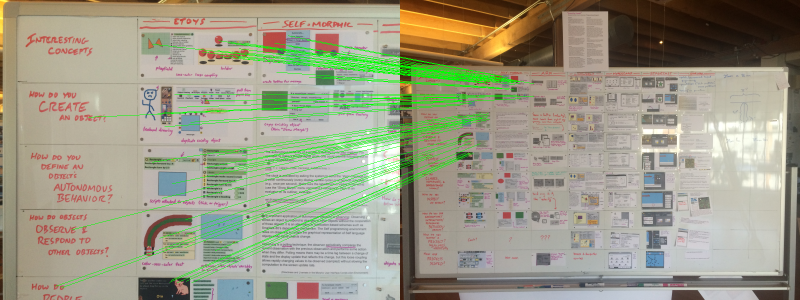

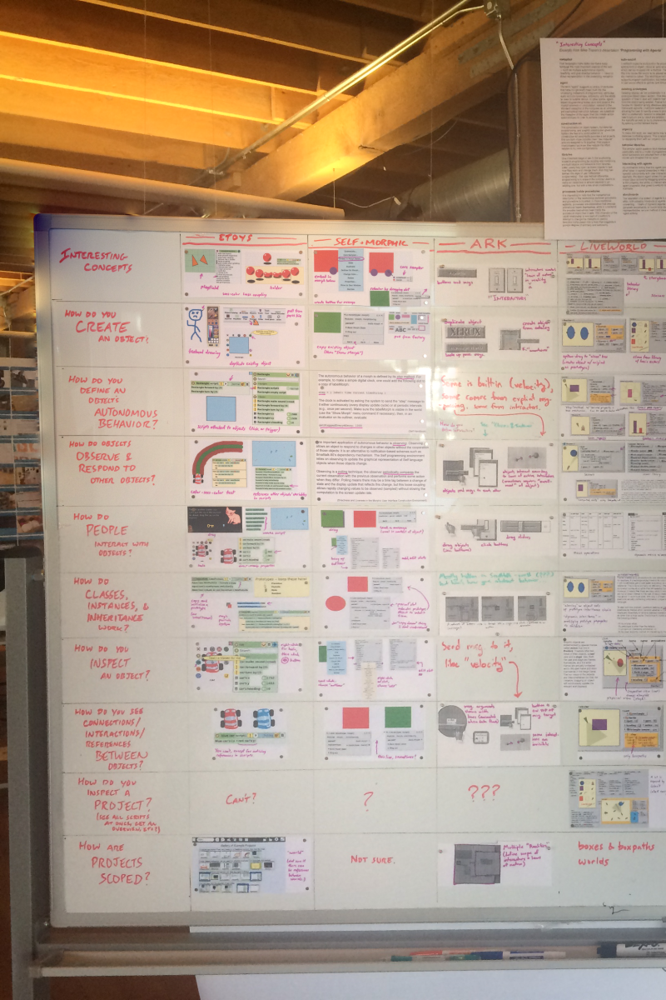

In [31]:
imageA_raw = cv2.imread('2016-03-14 17.46.19.jpg')
imageB_raw = cv2.imread('establishing.jpg')

imageA = imutils.resize(imageA, width=800)
imageB = imutils.resize(imageB, width=800)


descriptorsA = detect_and_describe(imageA)
descriptorsB = detect_and_describe(imageB)

ratio = 0.75
reprojThresh = 4.0

homography_from_descriptors = match_keypoints(descriptorsA, descriptorsB, ratio, reprojThresh)

vis = draw_matches(homography_from_descriptors)

show(vis)

scaling_factor = 3
downsampling_factor = float(imageA_raw.shape[1]) / 800
H_scaled = (
    scaling(scaling_factor)
    .dot(scaling(downsampling_factor))
    .dot(homography_from_descriptors.H)
    .dot(scaling(1.0/downsampling_factor))
)
imageB_scaled = imutils.resize(imageB_raw, width=imageB_raw.shape[1] * scaling_factor)
imageB_scaled = imageB_scaled[: , : imageB_scaled.shape[1] / 2, :]
# show(dumb_warp_onto(imageA_raw, imageB_scaled, H_scaled))
show(better_warp_onto(imageA_raw, imageB_scaled, H_scaled))

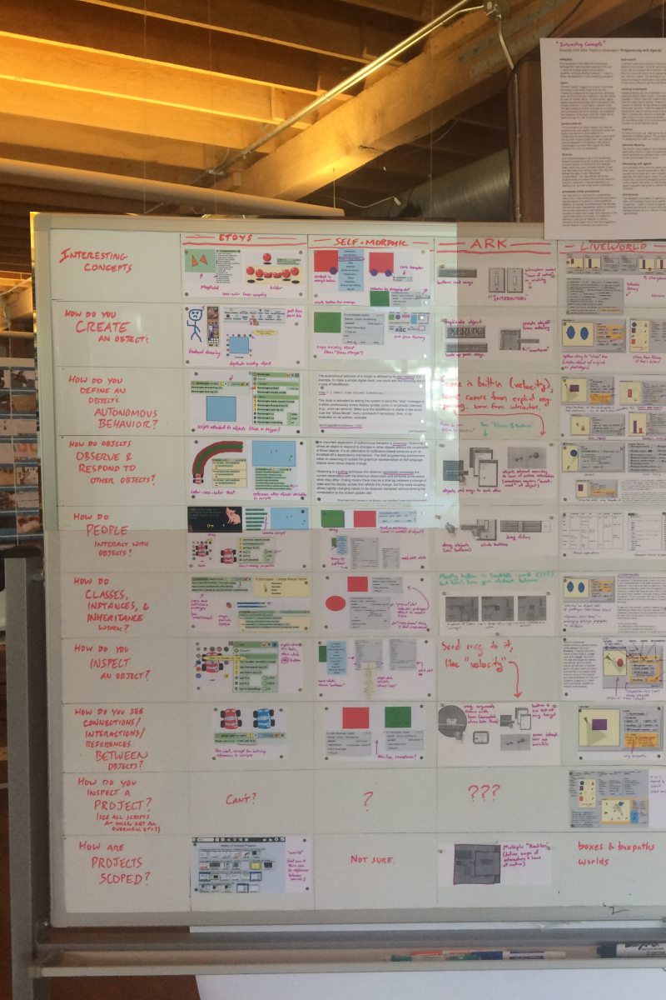

In [33]:
show(dumb_warp_onto(imageA_raw, imageB_scaled, H_scaled))

In [ ]:
mask

In [ ]:
import cv2.fe

In [ ]:
imageA.shape

In [ ]:
range(100)[10::-1]

In [6]:
def load_image(name):
    return cv2.imread(name)

def downsample(image):
    return imutils.resize(image, width=800)

establishing = load_image('establishing.jpg')
closes = map(load_image, [
    '2016-03-14 17.46.19.jpg', '2016-03-14 17.46.43.jpg', '2016-03-14 17.47.18.jpg',
    '2016-03-14 17.47.22.jpg', '2016-03-14 17.47.26.jpg', '2016-03-14 17.47.30.jpg',
    '2016-03-14 17.47.34.jpg', '2016-03-14 17.47.38.jpg', '2016-03-14 17.47.42.jpg',
    '2016-03-14 17.47.50.jpg', '2016-03-14 17.47.53.jpg', '2016-03-14 17.47.57.jpg',
    '2016-03-14 17.48.04.jpg', '2016-03-14 17.48.08.jpg', '2016-03-14 17.48.11.jpg',
    '2016-03-14 17.48.15.jpg', '2016-03-14 17.48.19.jpg'])

descriptors_e = detect_and_describe(downsample(establishing))
descriptors_cs = [detect_and_describe(downsample(close)) for close in closes]

ratio = 0.75
reprojThresh = 4.0

homographies = [match_keypoints(descriptors_c, descriptors_e, ratio, reprojThresh) for descriptors_c in descriptors_cs]

In [85]:
scaling_factor = 3
downsampling_factor = float(imageA_raw.shape[1]) / 800

def rescale_H(H):
    return (
        scaling(scaling_factor * downsampling_factor)
        .dot(H)
        .dot(scaling(1.0/downsampling_factor))
    )

establishing_scaled = imutils.resize(imageB_raw, width=imageB_raw.shape[1] * scaling_factor)
establishing_scaled = establishing_scaled[: , : establishing_scaled.shape[1] / 2, :]

composite = establishing_scaled.copy()
composite = better_warp_onto(closes[0], establishing_scaled, rescale_H(homographies[0].H))

NameError: name 'imageA_raw' is not defined

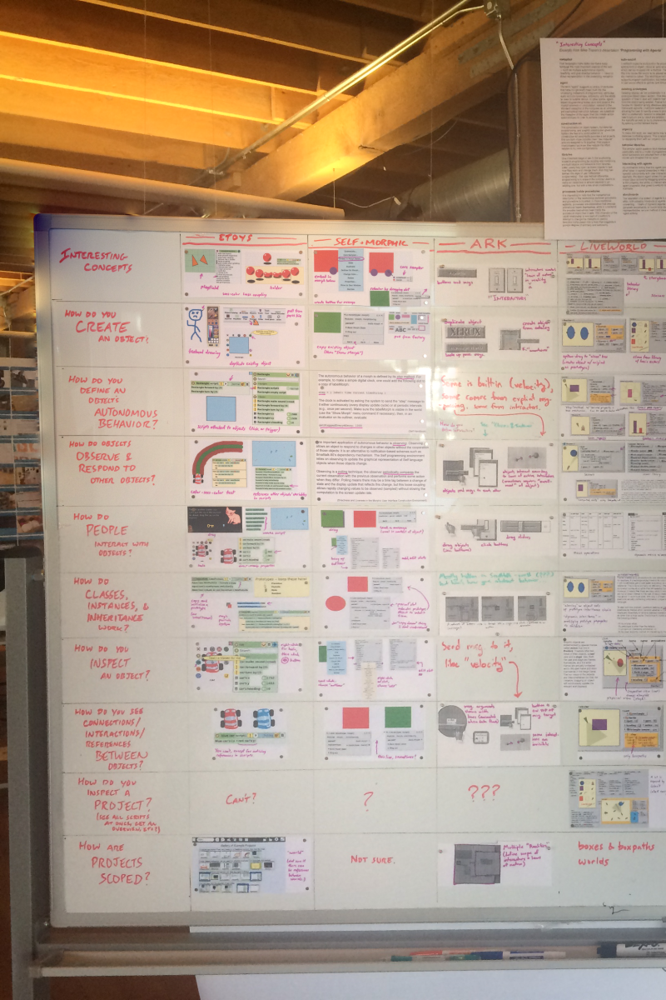

In [47]:
show(composite)

In [48]:
composite2 = better_warp_onto(closes[2], composite, rescale_H(homographies[2].H))

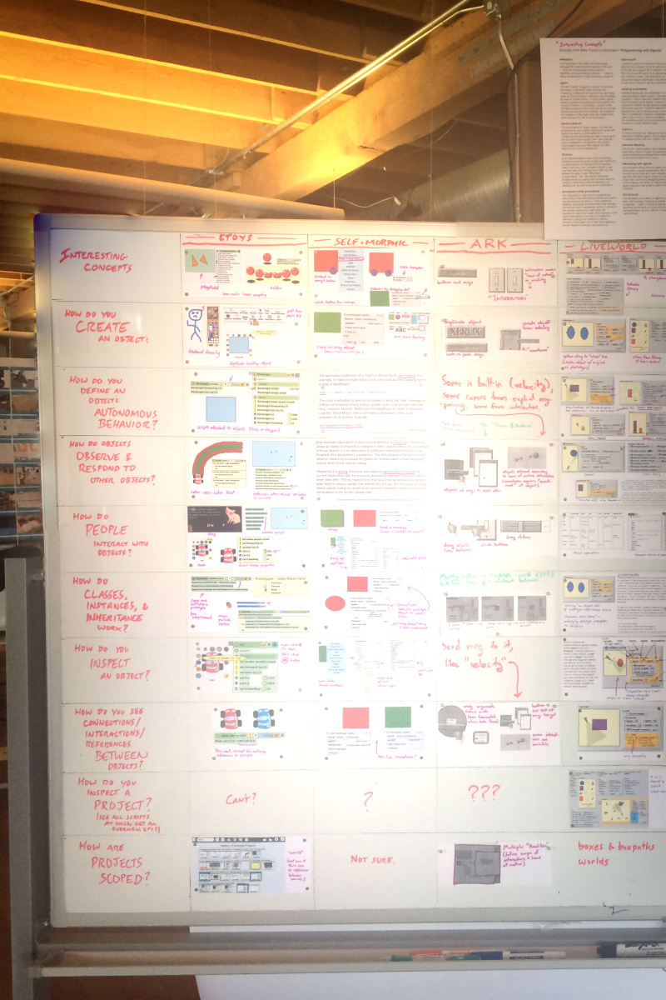

In [49]:
show(composite2)

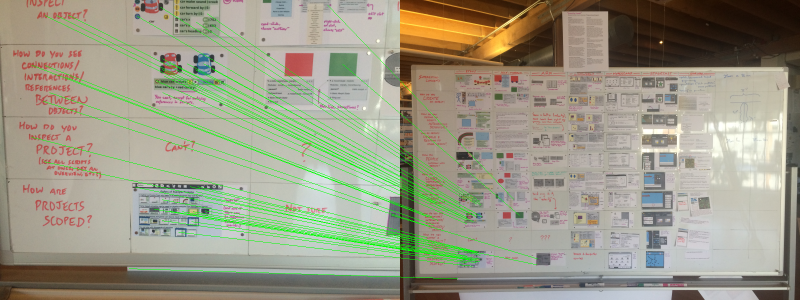

In [13]:
vis = draw_matches(homographies[4])

show(vis)

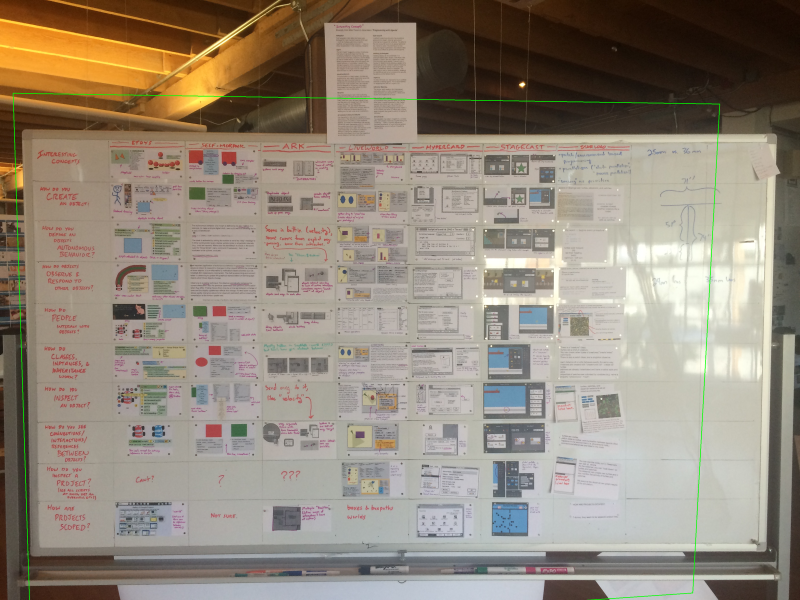

In [15]:
i = 0
H_scaled = (
        scaling(scaling_factor)
        .dot(homographies[i].H)
    )
show(draw_rect(closes[i], establishing.copy(), H_scaled))

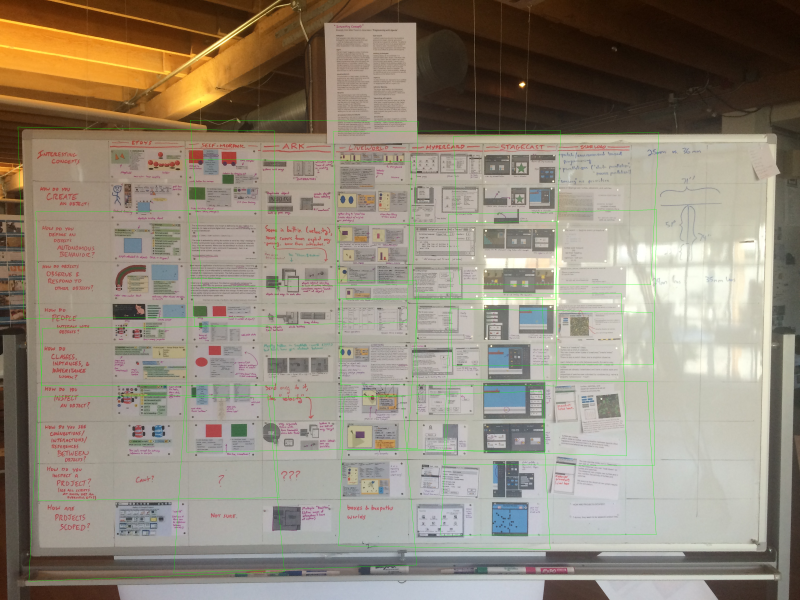

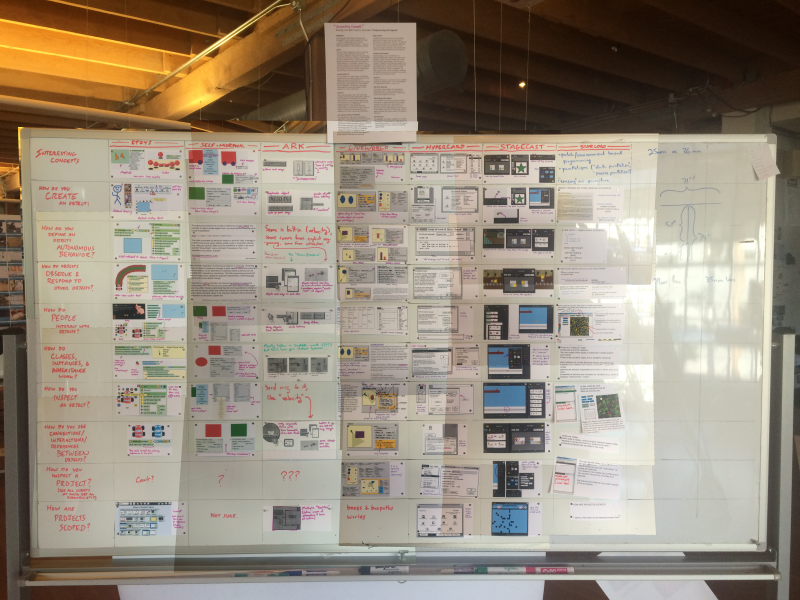

In [18]:
scaling_factor = 3
downsampling_factor = float(establishing.shape[1]) / 800

def rescale_H(H):
    return (
        scaling(scaling_factor * downsampling_factor)
        .dot(H)
        .dot(scaling(1.0/downsampling_factor))
    )

frames = imutils.resize(establishing, width=closes[0].shape[1] * scaling_factor)
composite1 = imutils.resize(establishing, width=closes[0].shape[1] * scaling_factor)
composite2 = imutils.resize(establishing, width=closes[0].shape[1] * scaling_factor)
for i in range(len(closes)):
    
    H_scaled = rescale_H(homographies[i].H)
    
    frames = draw_rect(closes[i], frames, H_scaled)
    
    close_scaled = imutils.resize(closes[i], width=closes[i].shape[1] * scaling_factor)
    composite1 = dumb_warp_onto(closes[i], composite1, H_scaled)
#     composite2 = better_warp_onto(closes[i], composite2, H_scaled)

show(frames)
show(composite1)
# show(composite2)

# Cloning by hand

In [273]:
x = np.array([1,2,3,4])
print x[np.array([False, True, True, False])]
x[np.array([False, True, True, False])] = 10
x

[2 3]


array([ 1, 10, 10,  4])

In [277]:
import skimage
import skimage.morphology
import pyviennacl as cl

def neighbor_sum(image):
    to_return = np.zeros_like(image)
    to_return[1:, :, :] += image[:-1, :, :]
    to_return[:-1, :, :] += image[1:, :, :]
    to_return[:, 1:, :] += image[:, :-1, :]
    to_return[:, :-1, :] += image[:, 1:, :]
    return to_return

def bestest_warp_onto(image1, image2, H):
    target, mask = warp(image1, image2, H)
    ref = image2

    rny = ref.shape[0]
    rnx = ref.shape[1]

    # Set up the arrays
    
    strict_interior = skimage.morphology.erosion(mask, np.ones((3,3), dtype=np.uint8))
    border          = mask - strict_interior

    strict_interior_indices                     = strict_interior.nonzero()
    num_strict_interior_pixels                  = strict_interior_indices[0].shape[0]
    variable_index_map                          = -1 * np.ones_like(mask, dtype=np.int32)
    variable_index_map[strict_interior_indices] = np.arange(num_strict_interior_pixels)
    
    
    # Construct the matrix

    with profile('setup.profile'):
        A = cl.CompressedMatrix(num_strict_interior_pixels, num_strict_interior_pixels, dtype=np.float32)

        ref_comp = ref.astype(np.int32)
        target_comp = target.astype(np.int32)
        B = np.zeros((num_strict_interior_pixels, 3), dtype=np.float32)

        target_neighbor_sum = neighbor_sum(target_comp)
        ref_border_neighbor_sum = neighbor_sum(ref_comp * np.repeat(border[:, :, np.newaxis], 3, axis=2))
        ones_neighbor_sum = neighbor_sum(np.ones_like(target_comp))
        
        sum_vq = ones_neighbor_sum * target_comp - target_neighbor_sum  # The beloved target Laplacian!
        sum_border_f = ref_border_neighbor_sum
        
        for i in range(num_strict_interior_pixels):        
            if i % 10000 == 0:
                print "Beginning pixel %i of %i" % (i, num_strict_interior_pixels)
                sys.stdout.flush()

            y = strict_interior_indices[0][i]
            x = strict_interior_indices[1][i]

            x_right = x+1
            x_left  = x-1

            y_up    = y-1
            y_down  = y+1

            assert( i == variable_index_map[y,x] )

            variable_indices_neighbors = []

            num_neighbors = 0
            num_neighbors_strict_interior = 0
            
            if x_right < rnx:
                index = variable_index_map[y,x_right]
                if index != -1:
                    A[i, int(index)] = -1

            if y_up >= 0:
                index = variable_index_map[y_up,x]
                if index != -1:
                    A[i, int(index)] = -1

            if x_left >= 0:
                index = variable_index_map[y,x_left]
                if index != -1:
                    A[i, int(index)] = -1

            if y_down < rny:
                index = variable_index_map[y_down,x]
                if index != -1:
                    A[i, int(index)] = -1

            A[i,i] = int(ones_neighbor_sum[y,x,0])

            B[i, :] = sum_vq[y,x,:] + sum_border_f[y,x,:]
    
    # Solve the matrix
    
    X = solve_matrix_for_image(A, B, ref[strict_interior_indices].astype(np.float32))

    # Composition
    
    ref_copy = ref.copy()
    ref_copy[strict_interior_indices] = np.clip(X, 0, 255).astype(np.uint8)

    return ref_copy

# Here, we assume A is a PVCL sparse matrix, but B and X0 should be numpy stuffs
def solve_matrix_for_image(A, B, X0, max_iterations=15):
    dX = np.zeros((A.shape[0], 3))
    
    tag = cl.gmres_tag(tolerance = 1e-5, max_iterations=max_iterations, krylov_dim=50)

    for color in range(3):
        now = time()
        full_B_for_color = B[:, color] - (A * X0[:, color]).value        
        dX[:, color] = cl.solve(A, cl.Vector(full_B_for_color), tag).value
        print "sec: ", time() - now
        sys.stdout.flush()
    
    return X0 + dX


MaskedImage = namedtuple('MaskedImage', ['image', 'mask'])

def multi_blend(background, masked_images):
    ref = background

    rny = ref.shape[0]
    rnx = ref.shape[1]

    # Set up the arrays

    mask_union = sum(masked_image.mask for masked_image in masked_images)
    mask_union[mask_union > 0] = 1

    strict_interior = skimage.morphology.erosion(mask_union, np.ones((3,3), dtype=np.uint8))
    border = mask_union - strict_interior
    
    strict_interior_indices = strict_interior.nonzero()
    num_strict_interior_pixels = strict_interior_indices[0].shape[0]
    variable_index_map = -1 * np.ones_like(mask_union, dtype=np.int32)
    variable_index_map[strict_interior_indices] = np.arange(num_strict_interior_pixels)
    
    
    # Construct the matrix

    with profile('setup.profile'):
        A = cl.CompressedMatrix(num_strict_interior_pixels, num_strict_interior_pixels, dtype=np.float32)

        ref_comp = ref.astype(np.int32)
        B = np.zeros((num_strict_interior_pixels, 3), dtype=np.float32)

        ones_neighbor_sum = neighbor_sum(np.ones_like(ref_comp))
        
        ref_border_neighbor_sum = neighbor_sum(ref_comp * np.repeat(border[:, :, np.newaxis], 3, axis=2))
        
        sum_border_f = ref_border_neighbor_sum
        
        sum_vq = np.zeros_like(ref_comp)  # The beloved target Laplacian!
        for masked_image in masked_images:
            target_comp = masked_image.image.astype(np.int32)
            target_mask = masked_image.mask.astype(bool)
            target_neighbor_sum = neighbor_sum(target_comp)
            sum_vq[target_mask] = (ones_neighbor_sum * target_comp - target_neighbor_sum)[target_mask]
        
        for i in range(num_strict_interior_pixels):        
            if i % 10000 == 0:
                print "Beginning pixel %i of %i" % (i, num_strict_interior_pixels)
                sys.stdout.flush()

            y = strict_interior_indices[0][i]
            x = strict_interior_indices[1][i]

            x_right = x+1
            x_left  = x-1

            y_up    = y-1
            y_down  = y+1

            assert( i == variable_index_map[y,x] )

            variable_indices_neighbors = []

            num_neighbors = 0
            num_neighbors_strict_interior = 0
            
            if x_right < rnx:
                index = variable_index_map[y,x_right]
                if index != -1:
                    A[i, int(index)] = -1

            if y_up >= 0:
                index = variable_index_map[y_up,x]
                if index != -1:
                    A[i, int(index)] = -1

            if x_left >= 0:
                index = variable_index_map[y,x_left]
                if index != -1:
                    A[i, int(index)] = -1

            if y_down < rny:
                index = variable_index_map[y_down,x]
                if index != -1:
                    A[i, int(index)] = -1

            A[i,i] = int(ones_neighbor_sum[y,x,0])

            B[i, :] = sum_vq[y,x,:] + sum_border_f[y,x,:]
    
    # Solve the matrix
    
    X = solve_matrix_for_image(A, B, ref[strict_interior_indices].astype(np.float32))

    # Composition
    
    ref_copy = ref.copy()
    ref_copy[strict_interior_indices] = np.clip(X, 0, 255).astype(np.uint8)

    return ref_copy


In [278]:
masked_images = [
    MaskedImage(*warp(downsample(closes[0]), downsample(establishing), homographies[0].H)),
    MaskedImage(*warp(downsample(closes[2]), downsample(establishing), homographies[2].H))
    ]
small_comp = multi_blend(downsample(establishing), masked_images)

Beginning pixel 0 of 61624
Beginning pixel 10000 of 61624
Beginning pixel 20000 of 61624
Beginning pixel 30000 of 61624
Beginning pixel 40000 of 61624
Beginning pixel 50000 of 61624
Beginning pixel 60000 of 61624
1.42988491058 seconds
sec:  9.98244905472
sec:  9.55640792847
sec:  10.1925959587


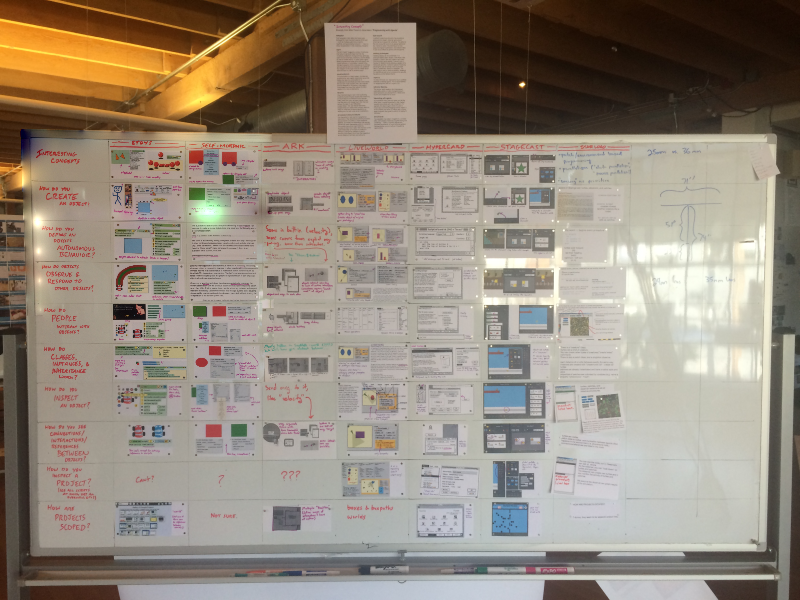

In [279]:
show(small_comp)

In [283]:
scaling_factor = 3
downsampling_factor = float(establishing.shape[1]) / 800

def rescale_H(H):
    return (
        scaling(scaling_factor * downsampling_factor)
        .dot(H)
        .dot(scaling(1.0/downsampling_factor))
    )

establishing_scaled = imutils.resize(establishing, width=establishing.shape[1] * scaling_factor)
establishing_scaled = establishing_scaled[: , : establishing_scaled.shape[1] / 2, :]

masked_images = [
    MaskedImage(*warp(closes[0], establishing_scaled, rescale_H(homographies[0].H))),
    MaskedImage(*warp(closes[2], establishing_scaled, rescale_H(homographies[2].H)))
    ]

composite = multi_blend(establishing_scaled, masked_images)

Beginning pixel 0 of 9571860
Beginning pixel 10000 of 9571860
Beginning pixel 20000 of 9571860
Beginning pixel 30000 of 9571860
Beginning pixel 40000 of 9571860
Beginning pixel 50000 of 9571860
Beginning pixel 60000 of 9571860
Beginning pixel 70000 of 9571860
Beginning pixel 80000 of 9571860
Beginning pixel 90000 of 9571860
Beginning pixel 100000 of 9571860
Beginning pixel 110000 of 9571860
Beginning pixel 120000 of 9571860
Beginning pixel 130000 of 9571860
Beginning pixel 140000 of 9571860
Beginning pixel 150000 of 9571860
Beginning pixel 160000 of 9571860
Beginning pixel 170000 of 9571860
Beginning pixel 180000 of 9571860
Beginning pixel 190000 of 9571860
Beginning pixel 200000 of 9571860
Beginning pixel 210000 of 9571860
Beginning pixel 220000 of 9571860
Beginning pixel 230000 of 9571860
Beginning pixel 240000 of 9571860
Beginning pixel 250000 of 9571860
Beginning pixel 260000 of 9571860
Beginning pixel 270000 of 9571860
Beginning pixel 280000 of 9571860
Beginning pixel 290000 of 95

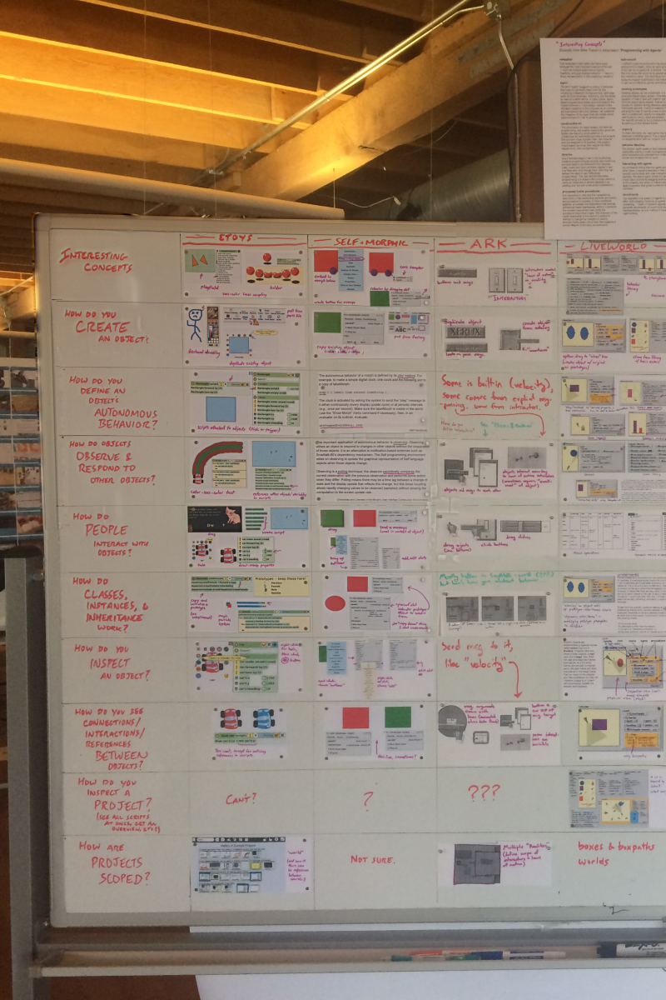

In [285]:
show(composite)

Beginning pixel 0 of 45770
Beginning pixel 10000 of 45770
Beginning pixel 20000 of 45770
Beginning pixel 30000 of 45770
Beginning pixel 40000 of 45770
1.06065893173 seconds
[ -15. -104.   57. ...,    3.    5.    3.] <type 'numpy.ndarray'>
sec:  10.2898430824
[  -6.  -78. -107. ...,    1.    2.    6.] <type 'numpy.ndarray'>
sec:  9.77731800079
[  35.   24. -130. ...,    2.   -3.    3.] <type 'numpy.ndarray'>
sec:  10.0830500126


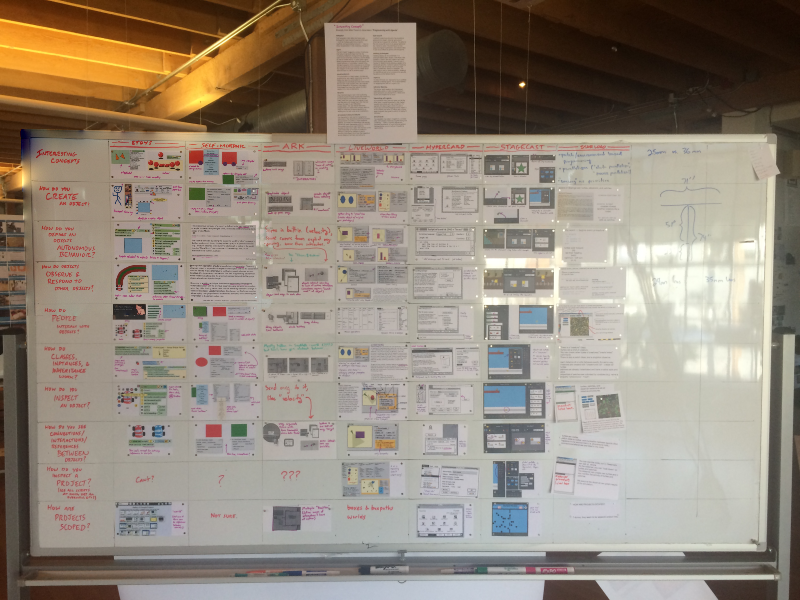

In [264]:
small_comp = bestest_warp_onto(downsample(closes[0]), downsample(establishing), homographies[0].H)
show(small_comp)

In [231]:
scaling_factor = 3
downsampling_factor = float(establishing.shape[1]) / 800

def rescale_H(H):
    return (
        scaling(scaling_factor * downsampling_factor)
        .dot(H)
        .dot(scaling(1.0/downsampling_factor))
    )

establishing_scaled = imutils.resize(establishing, width=establishing.shape[1] * scaling_factor)
establishing_scaled = establishing_scaled[: , : establishing_scaled.shape[1] / 2, :]

composite = establishing_scaled.copy()
composite = bestest_warp_onto(closes[0], establishing_scaled, rescale_H(homographies[0].H))

Beginning pixel 0 of 7157802
Beginning pixel 10000 of 7157802
Beginning pixel 20000 of 7157802
Beginning pixel 30000 of 7157802
Beginning pixel 40000 of 7157802
Beginning pixel 50000 of 7157802
Beginning pixel 60000 of 7157802
Beginning pixel 70000 of 7157802
Beginning pixel 80000 of 7157802
Beginning pixel 90000 of 7157802
Beginning pixel 100000 of 7157802
Beginning pixel 110000 of 7157802
Beginning pixel 120000 of 7157802
Beginning pixel 130000 of 7157802
Beginning pixel 140000 of 7157802
Beginning pixel 150000 of 7157802
Beginning pixel 160000 of 7157802
Beginning pixel 170000 of 7157802
Beginning pixel 180000 of 7157802
Beginning pixel 190000 of 7157802
Beginning pixel 200000 of 7157802
Beginning pixel 210000 of 7157802
Beginning pixel 220000 of 7157802
Beginning pixel 230000 of 7157802
Beginning pixel 240000 of 7157802
Beginning pixel 250000 of 7157802
Beginning pixel 260000 of 7157802
Beginning pixel 270000 of 7157802
Beginning pixel 280000 of 7157802
Beginning pixel 290000 of 71

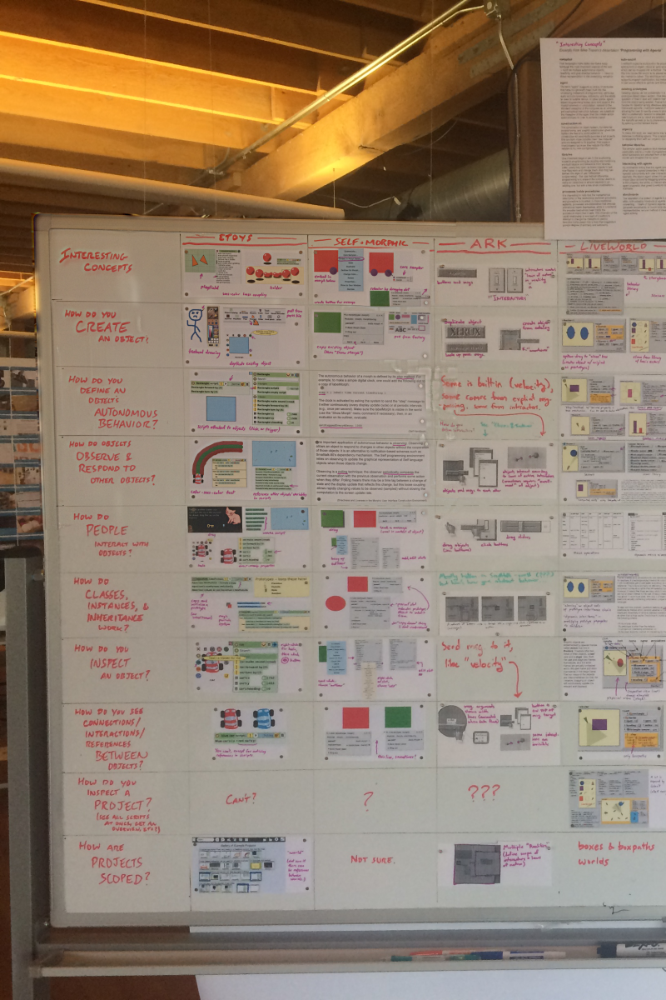

In [232]:
show(composite)

# Distortion

In [42]:
mtx = np.array([
    [686.90969798,0.,305.15396698],
    [0.,687.50880045,402.6500014],
    [0.,0.,1.]
])
distort = np.array([[ 0.0772465, -0.002549, 0.00149457, 0.00332625, -0.21693177]])



/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:10: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


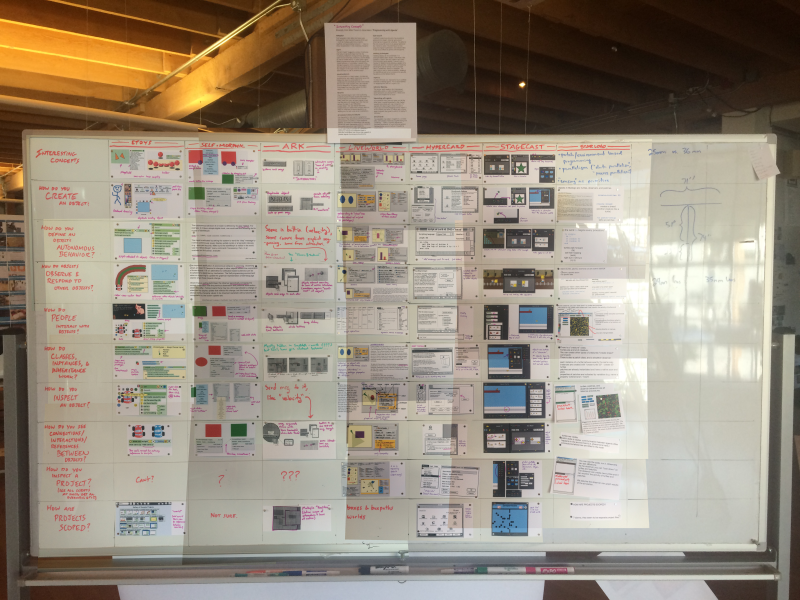

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpEKBHlp


In [54]:
scaling_factor = 3
downsampling_factor = float(establishing.shape[1]) / 800

def rescale_H(H):
    return (
        scaling(scaling_factor * downsampling_factor)
        .dot(H)
        .dot(scaling(1.0/downsampling_factor))
    )

frames = imutils.resize(establishing, width=closes[0].shape[1] * scaling_factor)
composite1 = imutils.resize(establishing, width=closes[0].shape[1] * scaling_factor)
composite2 = imutils.resize(establishing, width=closes[0].shape[1] * scaling_factor)
for i in range(len(closes)):
    
    H_scaled = rescale_H(homographies[i].H)

    newcameramtx, roi = cv2.getOptimalNewCameraMatrix(mtx, distort, closes[0].shape[1::-1], 1, closes[0].shape[1::-1])
    close_warped = cv2.undistort(closes[i], mtx, distort, None, newcameramtx)
    onto_mask = np.zeros_like(closes[0])
    onto_mask[100:-100, 100:-100, :] = 255
    composite1 = dumb_warp_onto(closes[i], composite1, H_scaled, erode = 1, onto_mask = onto_mask)

# show(frames)
show(composite1)
# show(composite2)

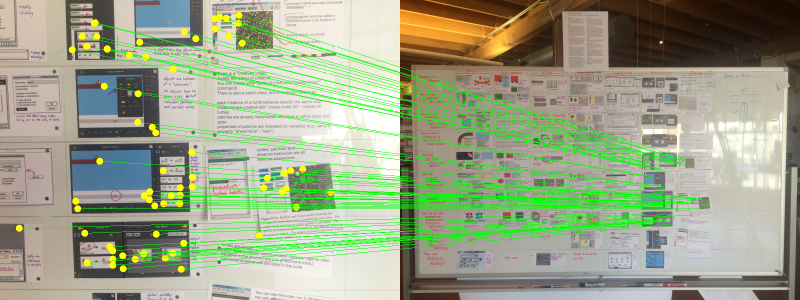

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpzGeWHW


In [31]:
vis = draw_matches(homographies[14])

show(vis)

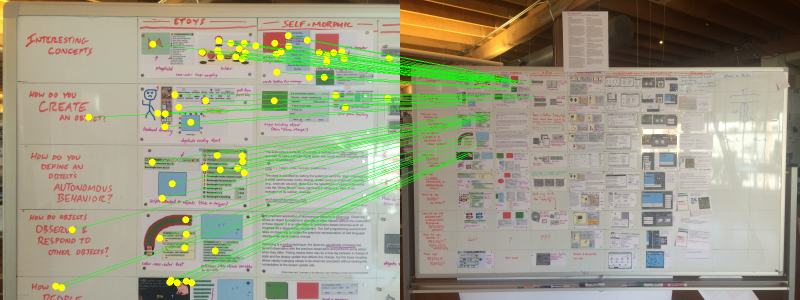

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpQafWGa


In [32]:
vis = draw_matches(homographies[0])

show(vis)

In [63]:
np.array([image_center(closes[0])])

array([[1632, 1224]])

In [99]:
(0, 0, establishing_scaled.shape[1], establishing_scaled.shape[0])

(0, 0, 9792, 7344)

In [86]:
establishing_scaled = imutils.resize(establishing, width=establishing.shape[1] * scaling_factor)

warped_centers = [
    cv2.perspectiveTransform(np.array([[image_center(closes[i])]], dtype=np.float32),
                             rescale_H(homographies[i].H))
    for i in range(len(closes))
]

subdiv = cv2.Subdiv2D((0, 0, establishing_scaled.shape[1], establishing_scaled.shape[0]))
for center in warped_centers:
    subdiv.insert(center)
    
(facets, centers) = subdiv.getVoronoiFacetList([])

In [88]:
(facets, centers) = subdiv.getVoronoiFacetList([])

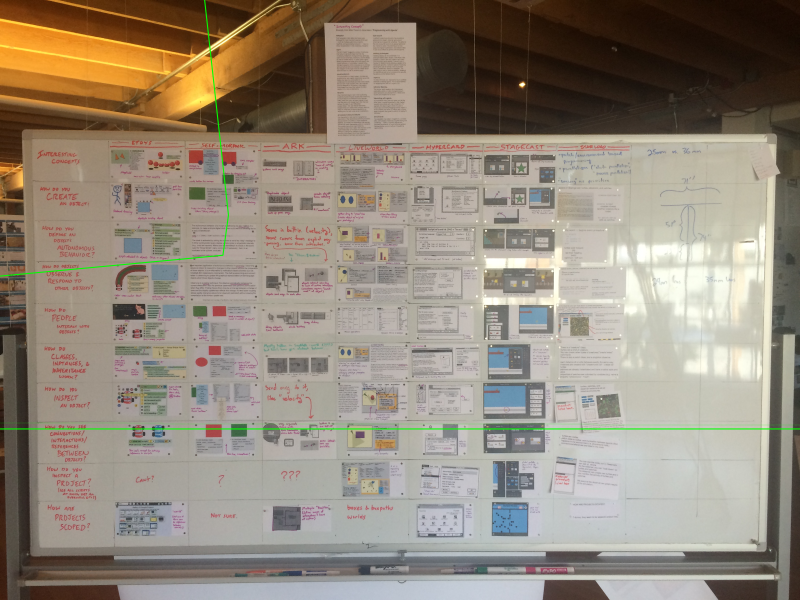

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpcwlwSC


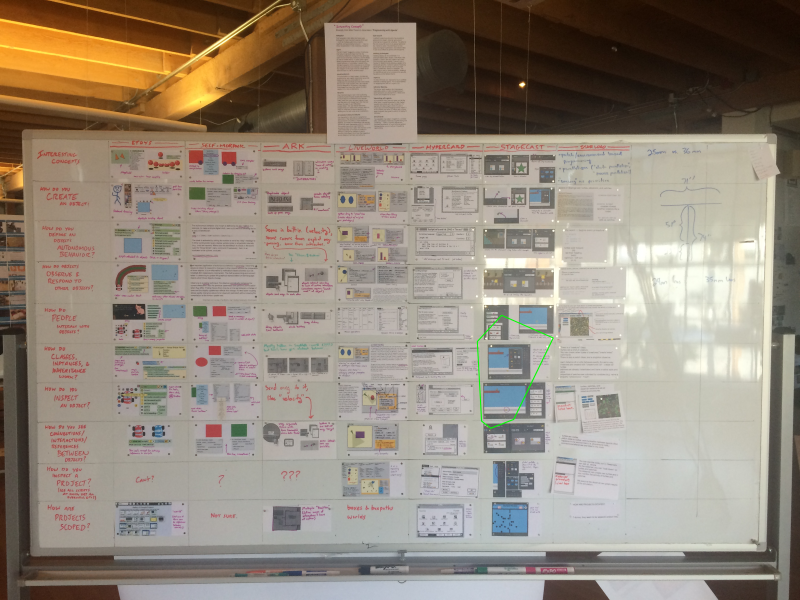

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpoujt7M


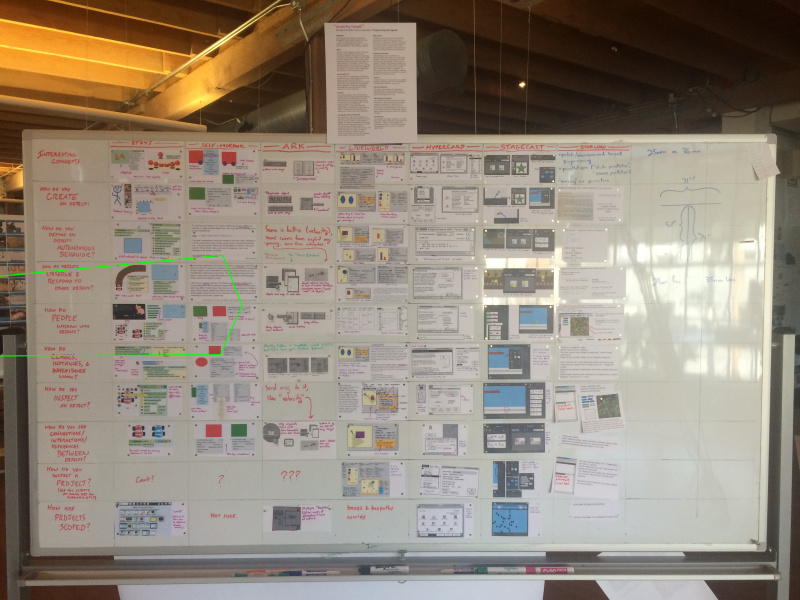

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpzalV1d


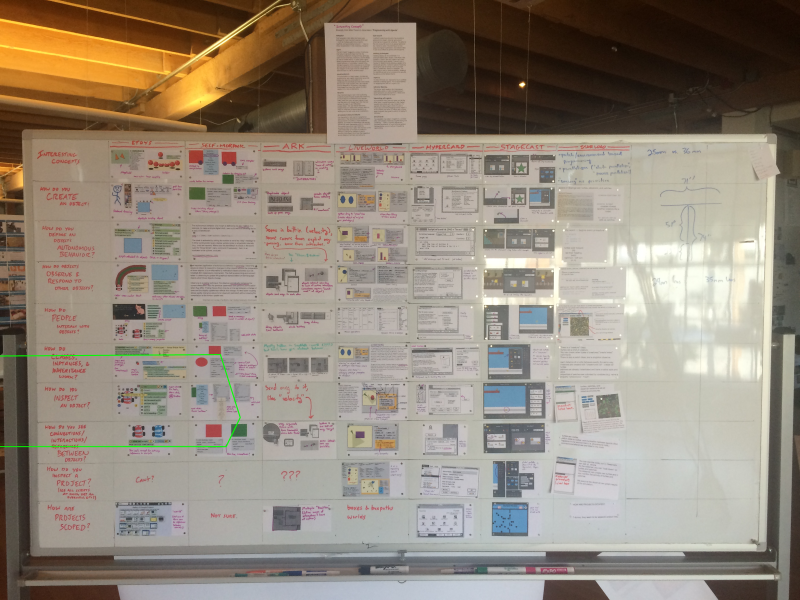

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpwIObFh


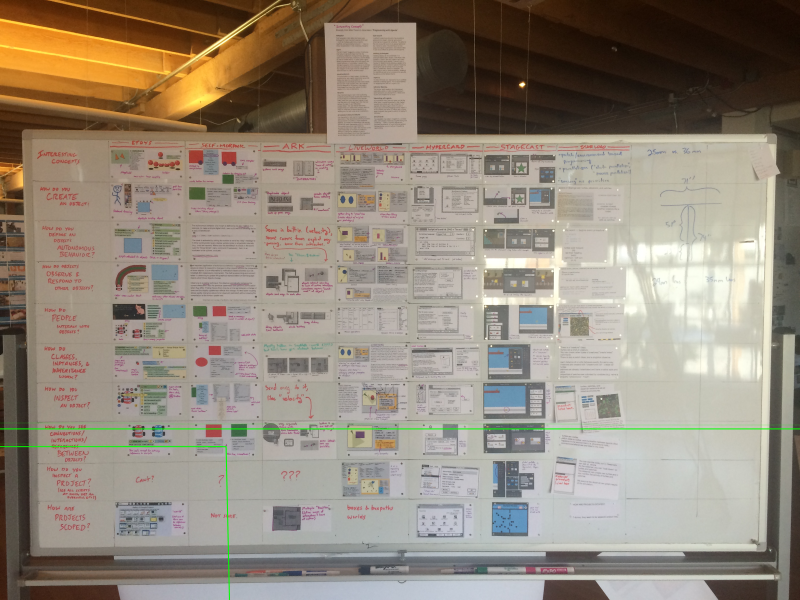

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpMEKLMm


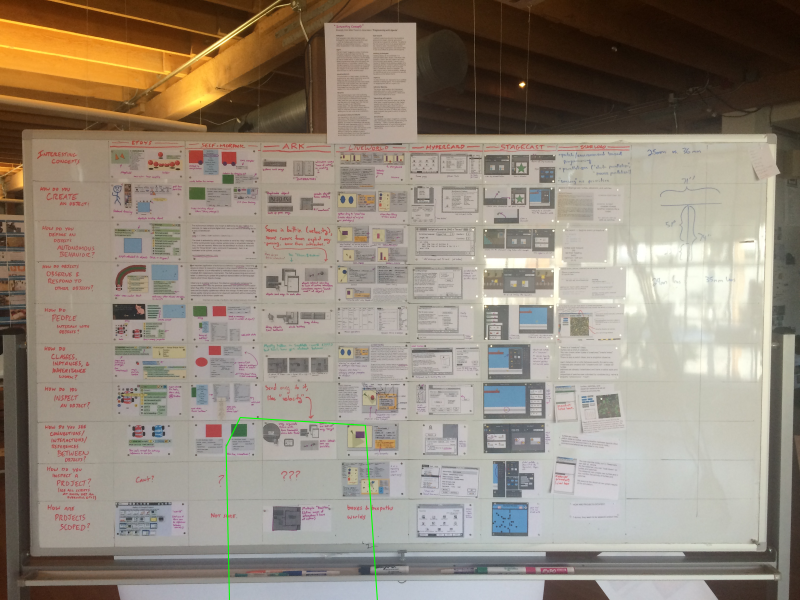

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpjEt_Yu


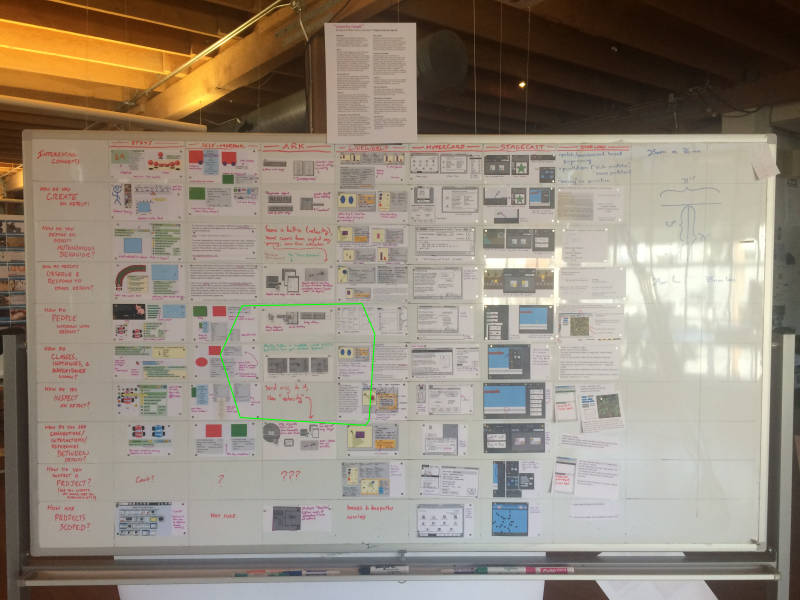

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpHWBdxD


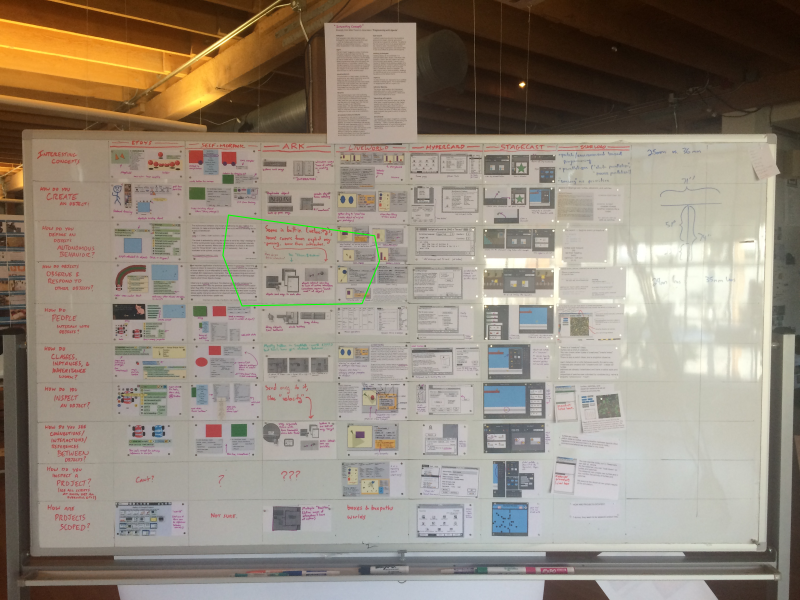

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpH79ij3


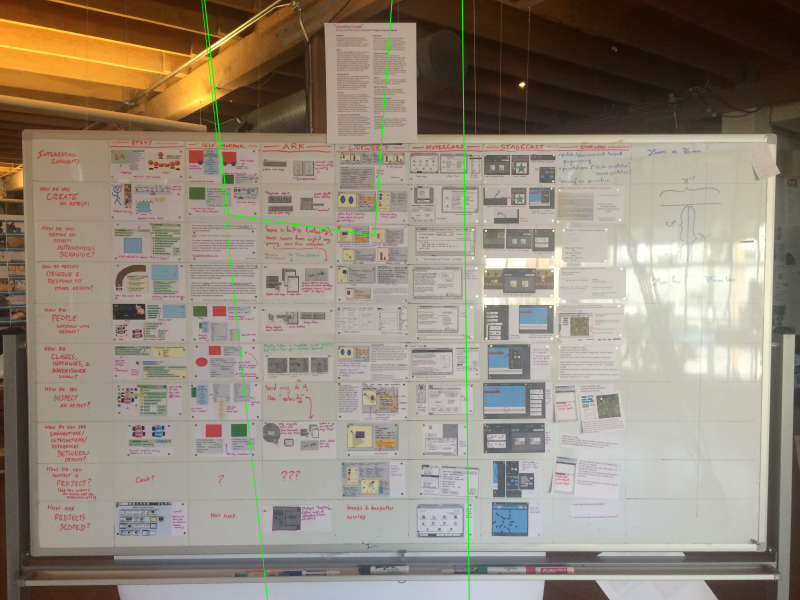

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpRWWOir


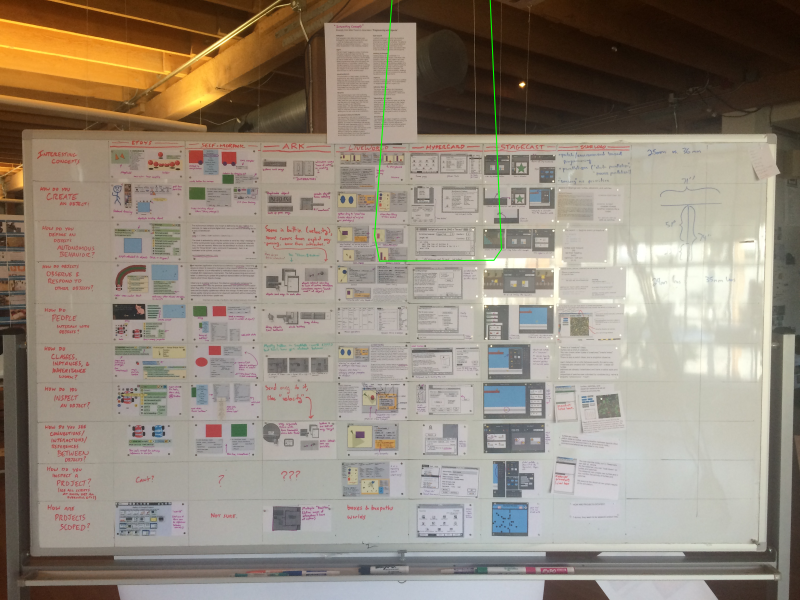

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpj9FKbR


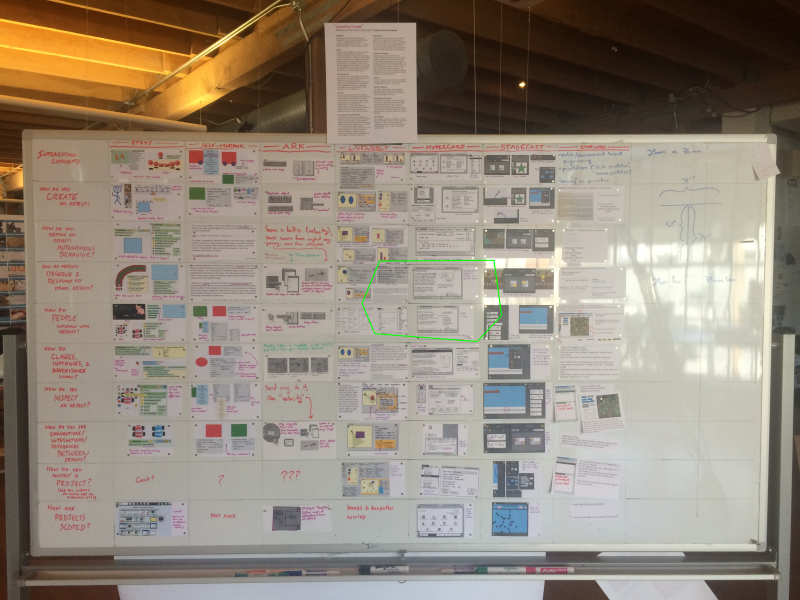

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmp7MC2g5


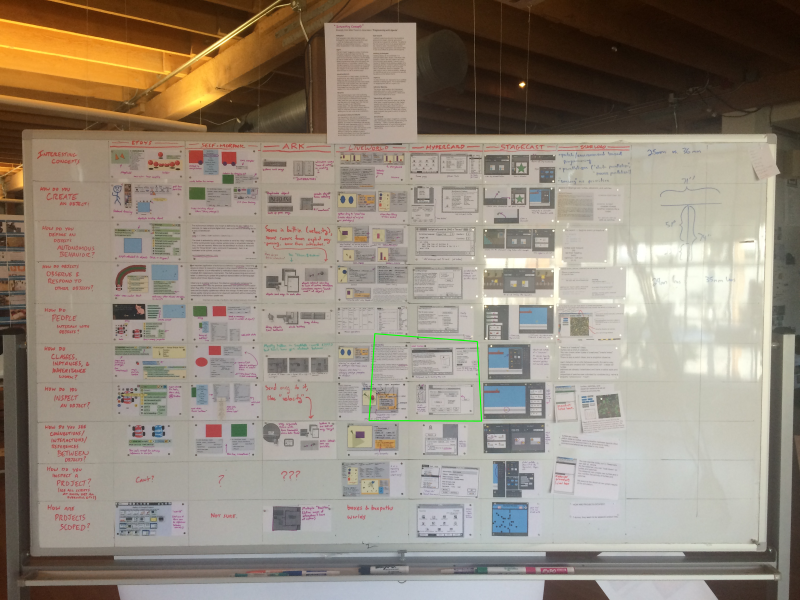

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpxEpdQL


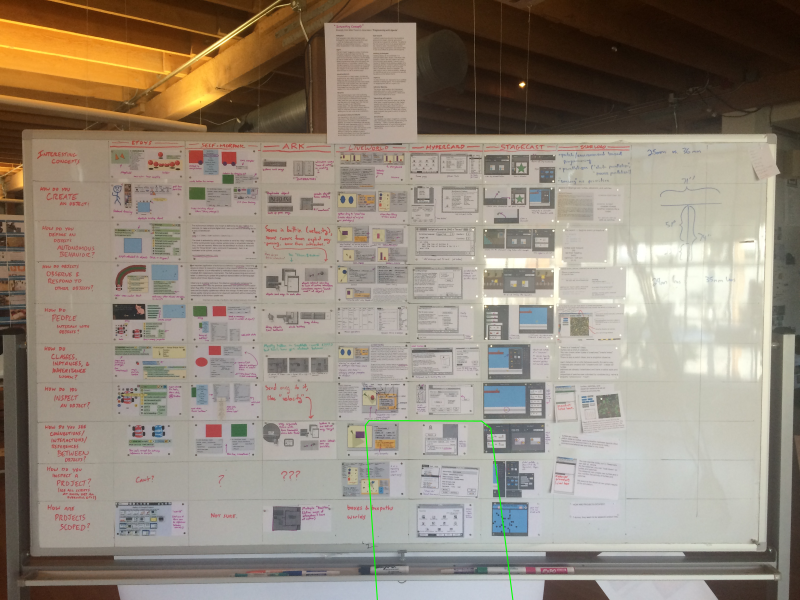

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpk7liso


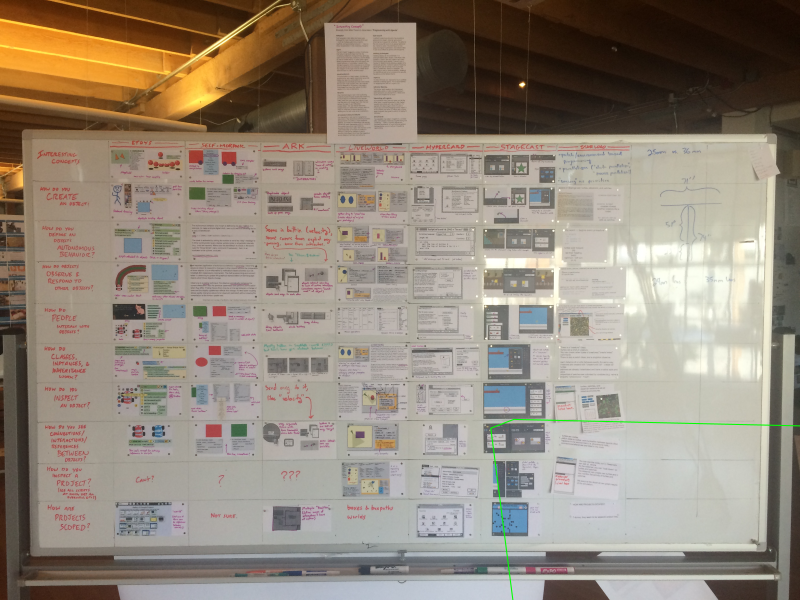

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpTxL25p


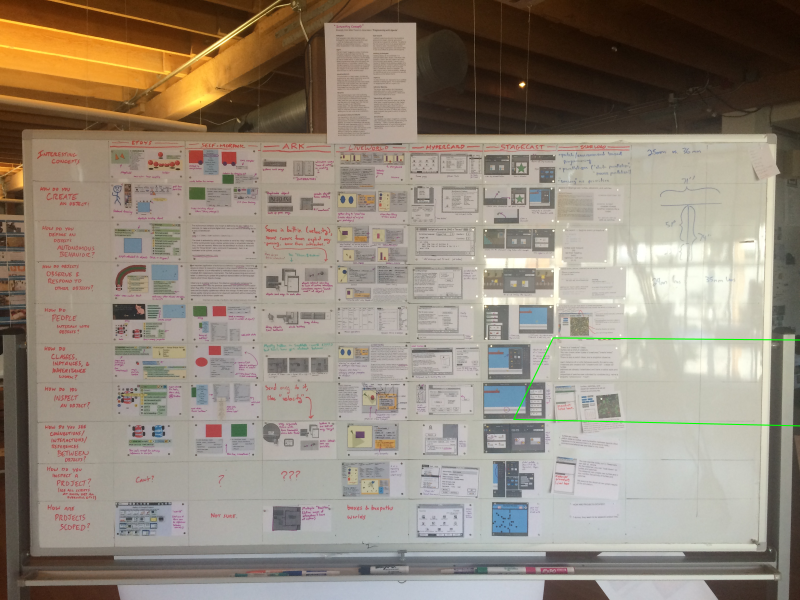

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmp2BQXxh


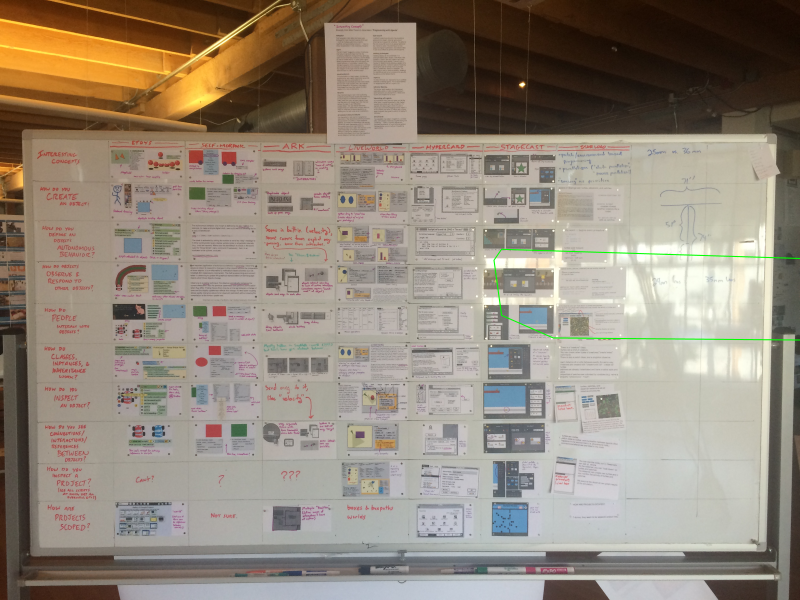

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmp64la2q


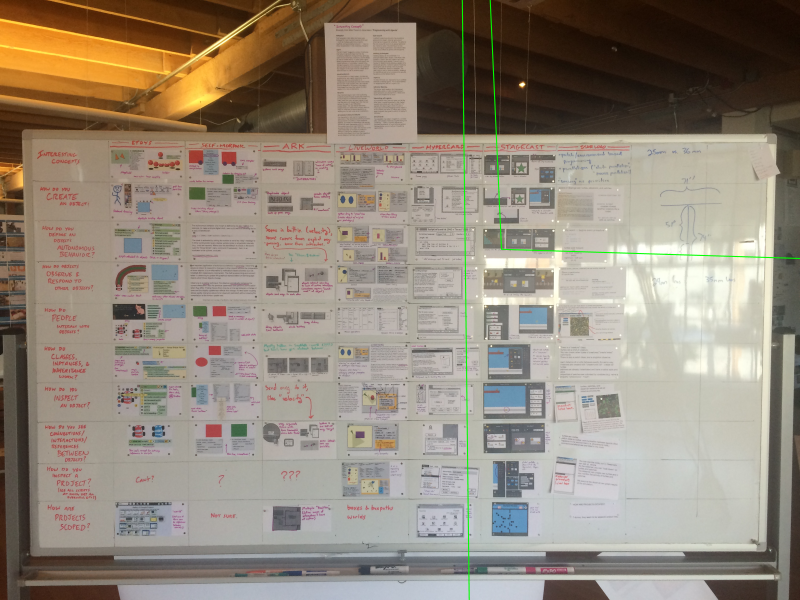

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmppKsQev


In [96]:
for facet in facets:
    diagram = establishing_scaled.copy()
    cv2.polylines(diagram, [facet.astype(np.int32)], True, (0, 255, 0), 11)
    show(diagram)

In [98]:
facets[0]

array([[  -410.57772827, -26299.04882812],
       [  2796.3059082 ,   2632.60888672],
       [  2728.7355957 ,   3124.20703125],
       [-11197.04199219,   4427.30126953],
       [-27791.921875  ,   5116.01025391],
       [-32880.0859375 ,   5253.13720703]], dtype=float32)

# OH YEAH LET'S DO THIS

array([[ 1.,  0.,  0.],
       [ 0.,  1.,  0.],
       [ 0.,  0.,  1.]])

In [146]:
a = np.array([1,2,3])

In [148]:
np.append([1,2], 4)

array([1, 2, 4])

In [276]:
# [IMAGE] SPACE: world a given image lives in (non-numeric, pretty abstract)
# [COORDINATE] SYSTEM: mapping from coordinates to point in image space
#
# In theory, an space has no canonical systems.
# In practice, we implement everything as follows:
#   A space is just a wrapper around an origin image array.
#   A system is just a space together with an affine transformation A so that the point corresponding to (x, y) is
#     A(x, y) in the original image. So the system of a downsampled image will have an affine transformation which
#     says "scale up the point!".
#   An image is an image array together with a system.

class ImageSpace:
    def __init__(self, origin_image=None, label=None):
        if origin_image is None:
            self._origin_image = None
        else:
            self.origin_image = origin_image
        self.label = label
            
    @property
    def origin_image(self):
        if self._origin_image is None:
            raise Error('Origin image not set on space yet.')
        return self._origin_image

    @origin_image.setter
    def origin_image(self, value):
        # TODO: validate
        self._origin_image = value

class CoordinateSystem:
    def __init__(self, space, transformation=None):
        self.space = space
        if transformation is not None:
            self.transformation = transformation
            self.inv_transformation = np.linalg.inv(transformation)
        else:
            self.transformation = np.eye(3)
            self.inv_transformation = np.eye(3)

    def translate(self, new_origin):
        translation = np.array([[1, 0, new_origin[0]], [0, 1, new_origin[1]], [0, 0, 1]])
        new_transformation = self.transformation.dot(translation)
        return CoordinateSystem(self.space, new_transformation)
        
    def rescale(self, factor):
        new_transformation = self.transformation.dot(np.diag([factor, factor, 1]))
        return CoordinateSystem(self.space, new_transformation)

    
    
    def to_base_coordinates(self, coordinates):
        return self.transformation.dot(np.append(coordinates, 1))[:-1]
    
    def from_base_coordinates(self, coordinates):
        return self.inv_transformation.dot(np.append(coordinates, 1))[:-1]
    
    def same_space(self, other_system):
        return self.space == other_system.space

        
class ImagePoint:
    # coordinates can be a list or a 1D numpy array
    def __init__(self, coordinates, system):
        self.coordinates = coordinates
        self.system = system
    
    def __repr__(self):
        return '<ImagePoint %s in CoordinateSystem %s>' % (repr(self.coordinates), hex(id(self.system)))

    def in_system(self, other_system):
        if not self.system.same_space(other_system):
            raise Error('Cannot interpret point (in %s) in %s!' % (repr(self.system), repr(other_system)))
        base_coordinates = self.system.to_base_coordinates(self.coordinates)
        return ImagePoint(other_system.from_base_coordinates(base_coordinates), other_system)
    
    def round_coordinates(self):
        return tuple(int(round(c)) for c in self.coordinates)

    
class Image:
    def __init__(self, array, system):
        # `array` shold be either
        #   height x width x 3 (for three-channel) or
        #   height x width (for one-channel)
        self.array = array
        self.system = system

    @staticmethod
    def from_array(array, label=None):
        space = ImageSpace(None, label)
        system = CoordinateSystem(space)
        image = Image(array, system)
        space.origin_image = image
        return image
    
    @property
    def width(self):
        return self.array.shape[1]
    
    @property
    def height(self):
        return self.array.shape[0]
    
    @property
    def dimensions(self):
        return self.array.shape[1::-1]
    
    def resize(self, width):
        new_system = self.system.rescale(float(self.width) / width)
        return Image(imutils.resize(self.array, width), new_system)
    
    def show(self):
        show(self.array)
        
    def __repr__(self):
        space_label = self.system.space.label
        maybe_label = (" " + space_label) if space_label else ""
        return "<Image (%i x %i)" % (self.width, self.height) + maybe_label + ">"

    def corners(self):
        w = self.width
        h = self.height
        return [ImagePoint(c, self.system) for c in [(0, 0), (w, 0), (w, h), (0, h)]]
    
    def __getitem__(self, key):
        if len(key) != 2:
            raise Error('Indexing on an Image requires exactly two arguments')
        x_key, y_key = key
        
        # This is either cropping or lookup...
        getitem_array = self.array.__getitem__((y_key, x_key))
        if len(getitem_array.shape) > 1:
            # There's probably an easier way to do this... (and no strides, please)
            x_translate = range(self.width)[x_key][0]
            y_translate = range(self.height)[y_key][0]
            cropped_system = self.system.translate([x_translate, y_translate])
            return Image(getitem_array, cropped_system)
        else:
            return getitem_array

    def draw_line(self, pt1, pt2, color=(0, 255, 0), width=1):
        array_copy = self.array.copy()
        pt1_here = pt1.in_system(self.system)
        pt2_here = pt2.in_system(self.system)
        cv2.line(array_copy, pt1_here.round_coordinates(), pt2_here.round_coordinates(), color, width)
        return Image(array_copy, self.system)

    def draw_circle(self, center, radius, color=(0, 255, 255), width=-1):
        array_copy = self.array.copy()
        center_here = center.in_system(self.system)
        cv2.circle(array_copy, center_here.round_coordinates(), radius, color, width)
        return Image(array_copy, self.system)
    
# Returns (output_image, embedding_left, embedding_right)
def abut(image1, image2):
    

In [277]:
k.system.transformation

array([[ 1.,  0.,  0.],
       [ 0.,  1.,  0.],
       [ 0.,  0.,  1.]])

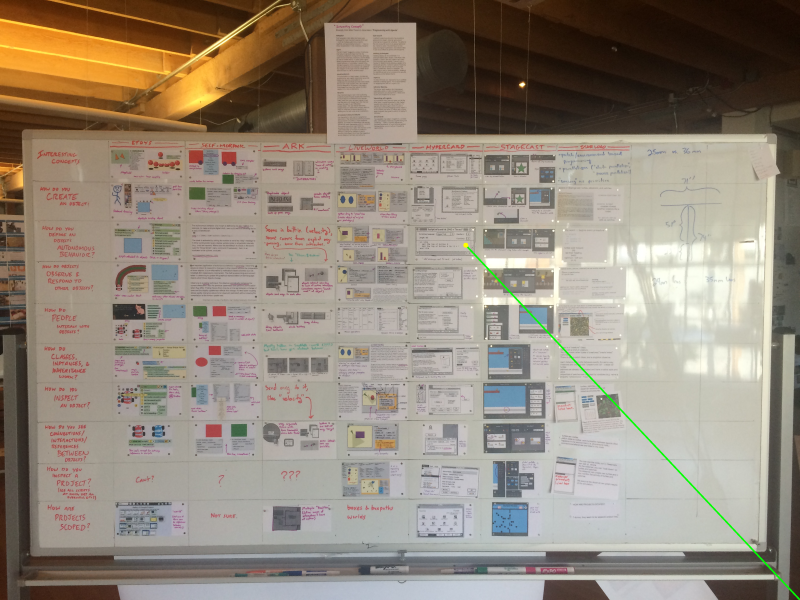

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpyWM0oi


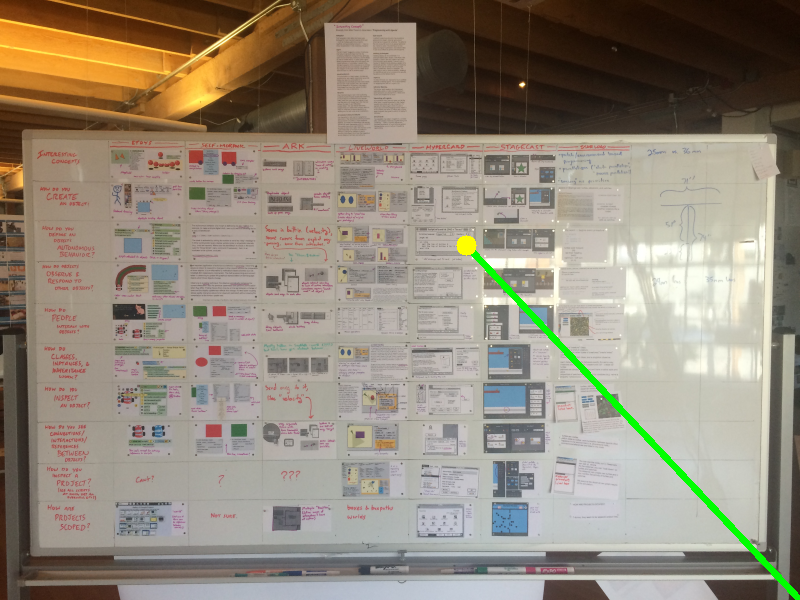

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmp8VV1MM


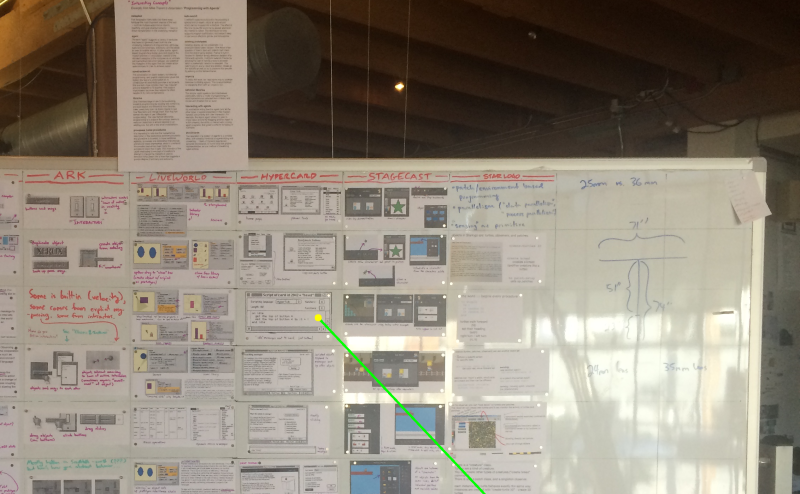

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmp314xHS


In [279]:
i = Image.from_array(establishing, 'establishing')
j = i.resize(800)
k = i[1000:, 100:1500]

# i_system = i.system
# print 'i system', i_system



# j_corner = j.corners()[1]
# j_corner.in_system(i_system)

corner1 = i.corners()[0]
corner2 = i.corners()[2]
third = ImagePoint([1900, 1000], corner1.system)
i.draw_line(third, corner2, width=5).draw_circle(third, 10).show()
j.draw_line(third, corner2, width=5).draw_circle(third, 10).show()
k.draw_line(third, corner2, width=5).draw_circle(third, 10).show()

i system <__main__.CoordinateSystem instance at 0x12584a710>
j system <__main__.CoordinateSystem instance at 0x125670098>


<ImagePoint array([ 3264.,     0.]) in CoordinateSystem 0x12584a710>

In [141]:
from pprint import pprint
pprint(i.corners())
pprint(i.resize(50).corners())

[<ImagePoint (0, 0) in CoordinateSystem 0x125cf73b0>,
 <ImagePoint (3264, 0) in CoordinateSystem 0x125cf73b0>,
 <ImagePoint (3264, 2448) in CoordinateSystem 0x125cf73b0>,
 <ImagePoint (0, 2448) in CoordinateSystem 0x125cf73b0>]
[<ImagePoint (0, 0) in CoordinateSystem 0x1256d4cb0>,
 <ImagePoint (50, 0) in CoordinateSystem 0x1256d4cb0>,
 <ImagePoint (50, 37) in CoordinateSystem 0x1256d4cb0>,
 <ImagePoint (0, 37) in CoordinateSystem 0x1256d4cb0>]


/usr/local/lib/python2.7/site-packages/ipykernel/__main__.py:33: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


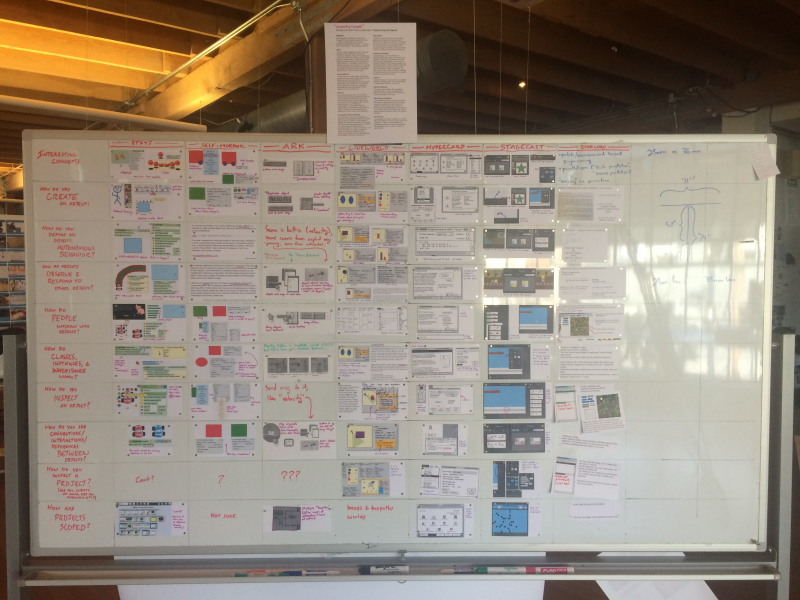

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpmwgvYE


In [102]:
show(establishing)


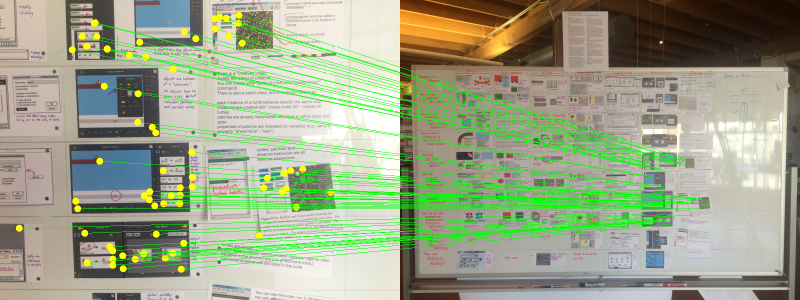

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpkDA_od


In [103]:
show(draw_matches(homographies[14]))

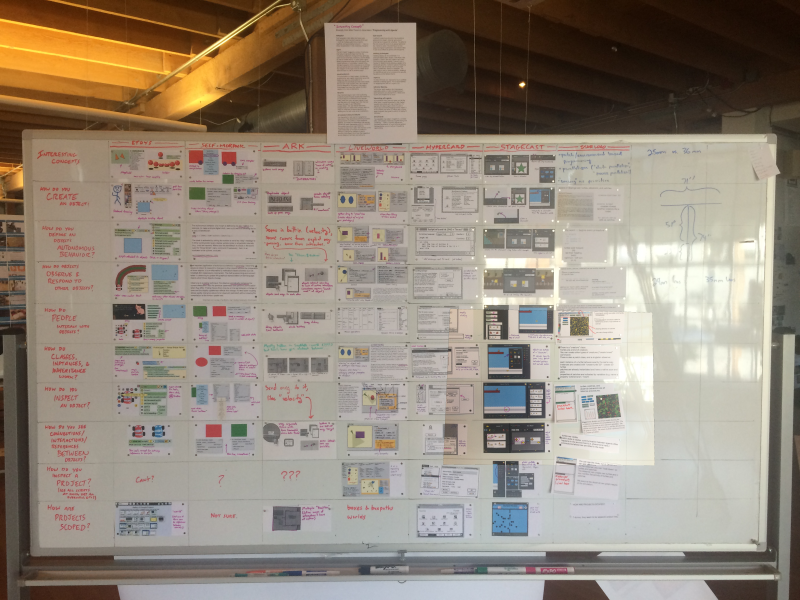

/var/folders/n_/9l2njh0101l0j31kb1xzkt040000gn/T/tmpeLqEDr


In [104]:
i = 14
show(dumb_warp_onto(closes[i], establishing_scaled, rescale_H(homographies[i].H)))